# SRCNN - From Scratch


In [1]:
import os
import time
import glob
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torchvision.models as models
import torchvision.utils as vutils
from torch.optim.lr_scheduler import CosineAnnealingLR

from skimage.metrics import peak_signal_noise_ratio, structural_similarity

class DIV2KDataset(Dataset):
    def __init__(self, root_dir, crop_size=96, scale=4, transform=None):
        """
        Args:
            root_dir (string): Directory with all the HR images.
            crop_size (int): High-resolution crop size.
            scale (int): Upscaling factor.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.files = sorted(glob.glob(os.path.join(root_dir, '*.png')))
        self.crop_size = crop_size
        self.scale = scale
        self.transform = transform

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        hr_image = Image.open(self.files[idx]).convert("RGB")

        # Random crop
        w, h = hr_image.size
        if w < self.crop_size or h < self.crop_size:
            hr_image = hr_image.resize((max(w, self.crop_size), max(h, self.crop_size)), Image.BICUBIC)
        left = random.randint(0, hr_image.width - self.crop_size)
        top = random.randint(0, hr_image.height - self.crop_size)
        hr_crop = hr_image.crop((left, top, left + self.crop_size, top + self.crop_size))
        
        # Create a low-resolution version using bicubic downsampling
        lr_crop = hr_crop.resize((self.crop_size // self.scale, self.crop_size // self.scale), Image.BICUBIC)
        
        # Additional augmentations: random flip and rotation
        if random.random() > 0.5:
            hr_crop = hr_crop.transpose(Image.FLIP_LEFT_RIGHT)
            lr_crop = lr_crop.transpose(Image.FLIP_LEFT_RIGHT)
        if random.random() > 0.5:
            hr_crop = hr_crop.transpose(Image.FLIP_TOP_BOTTOM)
            lr_crop = lr_crop.transpose(Image.FLIP_TOP_BOTTOM)
        if random.random() > 0.5:
            angle = random.choice([90, 180, 270])
            hr_crop = hr_crop.rotate(angle)
            lr_crop = lr_crop.rotate(angle)

        # Convert images to tensor and scale to [0,255]
        to_tensor = transforms.ToTensor()
        hr_tensor = to_tensor(hr_crop) * 255.0
        lr_tensor = to_tensor(lr_crop) * 255.0

        sample = {'lr': lr_tensor, 'hr': hr_tensor}
        if self.transform:
            sample = self.transform(sample)
        return sample

def psnr(sr, hr):
    mse = nn.functional.mse_loss(sr, hr)
    if mse == 0:
        return float('inf')
    return 20 * torch.log10(255.0 / torch.sqrt(mse))

In [2]:
# Define the SRCNN Models

class SRCNN_v1(nn.Module):
    def __init__(self):
        super(SRCNN_v1, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=9, padding=4)  
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(64, 32, kernel_size=5, padding=2)
        self.relu2 = nn.ReLU(inplace=True)
        self.conv3 = nn.Conv2d(32, 3, kernel_size=5, padding=2)  # Output is RGB so 3 channels
        # initializing weights
        # self.init_weights()
        
    def forward(self, x):
        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.conv3(x)
        return x
    

    def init_weights(self):
        # Official init from torch repo.
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                # nn.init.kaiming_normal_(m.weight)
                nn.init.normal_(m.weight, mean=0.0, std=0.001)
                nn.init.zeros_(m.bias)



class SRCNN_v2(nn.Module):
    def __init__(self):
        super(SRCNN_v2, self).__init__()
        self.conv1 = nn.Conv2d(3, 128, kernel_size=9, padding=4)  # Increase filters
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(128, 64, kernel_size=5, padding=2)
        self.relu2 = nn.ReLU(inplace=True)
        self.conv3 = nn.Conv2d(64, 32, kernel_size=3, padding=1)  # Add extra conv layer
        self.relu3 = nn.ReLU(inplace=True)
        self.conv4 = nn.Conv2d(32, 3, kernel_size=3, padding=1)  # Final layer
    
    def forward(self, x):
        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.relu3(self.conv3(x))
        x = self.conv4(x)
        return x

    def init_weights(self):
        # Official init from torch repo.
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                # nn.init.kaiming_normal_(m.weight)
                nn.init.normal_(m.weight, mean=0.0, std=0.001)
                nn.init.zeros_(m.bias)


In [3]:
def train_srcnn(
    train_loader,
    valid_loader,
    generator,
    device='cuda',
    epochs=50,
    lr=1e-4,
    save_dir='srcnn_weights',
    save_period=5,
    resume_generator=None,
    resume_epoch=0
):
    """
    Trains an SRCNN model using a reconstruction loss (MSE). 
    The LR images are first upsampled using bicubic interpolation to match the HR image size.
    
    Parameters:
        train_loader: DataLoader for training data (each batch with 'lr' and 'hr' images).
        valid_loader: DataLoader for validation data.
        generator: The SRCNN model.
        device (str): Device to run training on.
        epochs (int): Total number of training epochs.
        lr (float): Learning rate.
        save_dir (str): Directory to save model checkpoints.
        save_period (int): Save a checkpoint every 'save_period' epochs.
        resume_generator (str): Optional path to a saved generator to resume training.
        resume_epoch (int): Epoch number from which to resume training.
    """
    generator = generator.to(device)
    optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(0.9, 0.999))
    start_epoch = 1
    if resume_generator is not None:
        print(f"Resuming training from {resume_generator}")
        generator.load_state_dict(torch.load(resume_generator, map_location=device))
        start_epoch = resume_epoch + 1
        print(f"Resuming from epoch {start_epoch}")

    mse_loss = nn.MSELoss()
    
    for epoch in range(start_epoch, epochs + 1):
        generator.train()
        running_loss = 0.0
        start_time = time.time()
        
        for batch in train_loader:
            lr_img = batch['lr'].to(device)   # LR image with smaller dimensions
            hr_img = batch['hr'].to(device)   # HR image with crop_size dimensions
            
            # Upsample LR image to match HR image dimensions using bicubic interpolation
            lr_img_up = nn.functional.interpolate(lr_img, size=hr_img.shape[-2:], mode='bicubic', align_corners=False)
            
            optimizer_G.zero_grad()
            sr_img = generator(lr_img_up)
            loss = mse_loss(sr_img, hr_img)
            loss.backward()
            optimizer_G.step()
            
            running_loss += loss.item()
        
        # Validate and compute average PSNR
        generator.eval()
        psnr_total = 0.0
        with torch.no_grad():
            for batch in valid_loader:
                lr_img = batch['lr'].to(device)
                hr_img = batch['hr'].to(device)
                # Upsample LR image to HR dimensions
                lr_img_up = nn.functional.interpolate(lr_img, size=hr_img.shape[-2:], mode='bicubic', align_corners=False)
                sr_img = generator(lr_img_up)
                sr_img = torch.clamp(sr_img, 0, 255)
                # Convert tensors to numpy arrays for skimage.metrics.peak_signal_noise_ratio
                sr_np = sr_img.cpu().numpy()
                hr_np = hr_img.cpu().numpy()
                psnr_total += peak_signal_noise_ratio(hr_np, sr_np, data_range=255)
        avg_psnr = psnr_total / len(valid_loader)
        
        print(f"Epoch [{epoch}/{epochs}], Time: {time.time()-start_time:.2f}s, "
              f"Train Loss: {running_loss/len(train_loader):.4f}, Val PSNR: {avg_psnr:.2f}")
        
        if epoch % save_period == 0:
            os.makedirs(save_dir, exist_ok=True)
            checkpoint_path = os.path.join(save_dir, f"generator_epoch_{epoch}.pth")
            torch.save(generator.state_dict(), checkpoint_path)
            print(f"Saved checkpoint: {checkpoint_path}")


In [7]:
# Define the scales and SRCNN variants to test.
scales = [2, 4, 8]
variants = {
    "SRCNN_v1": SRCNN_v1,
    "SRCNN_v2": SRCNN_v2,
}

# Paths to your training and validation HR images (modify as needed)
train_dir = "DIV2K/DIV2K_train_HR"
valid_dir = "DIV2K/DIV2K_valid_HR"

# Training parameters
epochs = 100
batch_size = 100
learning_rate = 1e-4

# Loop over each scale and each variant
for scale in scales:
    for variant_name, model_class in variants.items():
        print(f"Training {variant_name} at scale {scale}x")
        
        # Instantiate the model and initialize weights if desired.
        model = model_class()
        # Optionally initialize weights:
        model.init_weights()
        
        # Create the datasets and DataLoaders with the appropriate scale.
        train_dataset = DIV2KDataset(root_dir=train_dir, crop_size=96, scale=scale)
        valid_dataset = DIV2KDataset(root_dir=valid_dir, crop_size=96, scale=scale)
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
        valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False, num_workers=4)
        
        # Define a save directory for this variant and scale.
        current_save_dir = os.path.join("srcnn_weights", variant_name, f"X{scale}")
        os.makedirs(current_save_dir, exist_ok=True)
        
        # Train the model using the provided training function.
        train_srcnn(
            train_loader=train_loader,
            valid_loader=valid_loader,
            generator=model,
            device='cuda',
            epochs=epochs,
            lr=learning_rate,
            save_dir=current_save_dir,
            save_period=20
        )


Training SRCNN_v1 at scale 2x
Epoch [1/100], Time: 16.38s, Train Loss: 17056.3298, Val PSNR: 6.50
Epoch [2/100], Time: 16.20s, Train Loss: 15203.4204, Val PSNR: 7.85
Epoch [3/100], Time: 16.68s, Train Loss: 6410.0254, Val PSNR: 17.15
Epoch [4/100], Time: 16.37s, Train Loss: 2839.4088, Val PSNR: 15.10
Epoch [5/100], Time: 16.35s, Train Loss: 1861.6883, Val PSNR: 15.32
Epoch [6/100], Time: 16.17s, Train Loss: 1890.4637, Val PSNR: 16.41
Epoch [7/100], Time: 16.30s, Train Loss: 1557.3307, Val PSNR: 16.56
Epoch [8/100], Time: 16.39s, Train Loss: 1545.5547, Val PSNR: 16.85
Epoch [9/100], Time: 16.31s, Train Loss: 1499.2665, Val PSNR: 16.62
Epoch [10/100], Time: 16.61s, Train Loss: 1477.4510, Val PSNR: 16.50
Epoch [11/100], Time: 16.03s, Train Loss: 1412.6731, Val PSNR: 16.99
Epoch [12/100], Time: 16.56s, Train Loss: 1495.3535, Val PSNR: 16.85
Epoch [13/100], Time: 16.18s, Train Loss: 1516.7758, Val PSNR: 16.77
Epoch [14/100], Time: 16.13s, Train Loss: 1452.3296, Val PSNR: 16.69
Epoch [15/100

In [18]:
class LRImageDataset(Dataset):
    def __init__(self, root_dir):
        """
        Args:
            root_dir (string): Directory with LR images.
        """
        self.files = sorted(glob.glob(os.path.join(root_dir, '*.png')))
        self.to_tensor = transforms.ToTensor()  # Converts image to [0, 1] tensor

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        img = Image.open(self.files[idx]).convert("RGB")
        tensor = self.to_tensor(img) * 255.0  # Scale to [0,255] as expected by our model
        return {'lr': tensor, 'filename': os.path.basename(self.files[idx])}
        
def test_model(model_path, lr_data_dir, hr_data_dir, output_dir, scale, device='cuda', variant='v1'):
    # Initialize generator and load saved weights
    if variant == 'v2':
        generator = SRCNN_v2().to(device)
    else:
        generator = SRCNN_v1().to(device)
    generator.load_state_dict(torch.load(model_path, map_location=device))
    generator.eval()
    
    # Create dataset and dataloader for LR images
    dataset = LRImageDataset(lr_data_dir)
    dataloader = DataLoader(dataset, batch_size=1, shuffle=False)
    
    os.makedirs(output_dir, exist_ok=True)
    
    total_psnr = 0.0
    total_ssim = 0.0
    count = 0

    with torch.no_grad():
        for batch in dataloader:
            lr_img = batch['lr'].to(device)  # [1, 3, H, W] with values in [0,255]
            filename = batch['filename'][0]

            target_size = lr_img.shape[-2]*scale, lr_img.shape[-1]*scale
            lr_img = nn.functional.interpolate(lr_img, size=target_size, mode='bicubic', align_corners=False)
            
            # Generate SR image and clamp values to [0, 255]
            sr_img = generator(lr_img)
            sr_img = torch.clamp(sr_img, 0, 255)
            
            # Save the SR image (normalize to [0,1] for saving)
            out_path = os.path.join(output_dir, filename)
            vutils.save_image(sr_img[0] / 255.0, out_path)
            print(f"Saved {out_path}.")
            
            # Load the corresponding HR image from hr_data_dir
            hr_path = os.path.join(hr_data_dir, filename)
            if os.path.exists(hr_path):
                hr_img_pil = Image.open(hr_path).convert("RGB")
                hr_np = np.array(hr_img_pil)
                
                # Convert the SR image to a numpy array, shape: (H, W, 3) and type uint8
                sr_np = sr_img[0].cpu().numpy().transpose(1, 2, 0).astype(np.uint8)

                # If HR and SR shapes differ, crop the HR image to the SR image's shape
                if hr_np.shape[0] != sr_np.shape[0] or hr_np.shape[1] != sr_np.shape[1]:
                    print(f"Cropping HR image from {hr_np.shape} to match SR shape {sr_np.shape}")
                    hr_np = hr_np[:sr_np.shape[0], :sr_np.shape[1], :]
                
                # Compute PSNR and SSIM
                psnr_val = peak_signal_noise_ratio(hr_np, sr_np, data_range=255)
                ssim_val = structural_similarity(hr_np, sr_np, win_size=3, multichannel=True, data_range=255)
                
                total_psnr += psnr_val
                total_ssim += ssim_val
                count += 1
                
                print(f"Image {filename} -> PSNR: {psnr_val:.2f}, SSIM: {ssim_val:.4f}")
            else:
                print(f"HR image not found for {filename}. Skipping metrics computation.")
    
    if count > 0:
        avg_psnr = total_psnr / count
        avg_ssim = total_ssim / count
        print(f"Average PSNR: {avg_psnr:.2f}, Average SSIM: {avg_ssim:.4f}")
    else:
        print("No HR images found. Metrics not computed.")

In [19]:
scales = [2, 4, 8]
hr_data_dir = 'DIV2K/DIV2K_valid_HR'
for scale in scales:
    lr_data_dir = f'DIV2K/DIV2K_valid_LR/X{scale}'
    model_path = f'srcnn_weights/SRCNN_v1/X{scale}/generator_epoch_100.pth'
    output_dir = f'results/srcnn_v1/X{scale}'
    test_model(model_path, lr_data_dir, hr_data_dir, output_dir, scale, device='cuda', variant='v1')
    
    model_path = f'srcnn_weights/SRCNN_v2/X{scale}/generator_epoch_100.pth'
    output_dir = f'results/srcnn_v2/X{scale}'
    test_model(model_path, lr_data_dir, hr_data_dir, output_dir, scale, device='cuda', variant='v2')

Saved results/srcnn_v1/X2/0801.png.
Image 0801.png -> PSNR: 29.77, SSIM: 0.8311
Saved results/srcnn_v1/X2/0802.png.
Image 0802.png -> PSNR: 18.97, SSIM: 0.6374
Saved results/srcnn_v1/X2/0803.png.
Image 0803.png -> PSNR: 19.96, SSIM: 0.7046
Saved results/srcnn_v1/X2/0804.png.
Image 0804.png -> PSNR: 25.91, SSIM: 0.8091
Saved results/srcnn_v1/X2/0805.png.
Image 0805.png -> PSNR: 29.13, SSIM: 0.8468
Saved results/srcnn_v1/X2/0806.png.
Image 0806.png -> PSNR: 25.93, SSIM: 0.8606
Saved results/srcnn_v1/X2/0807.png.
Image 0807.png -> PSNR: 17.48, SSIM: 0.5500
Saved results/srcnn_v1/X2/0808.png.
Image 0808.png -> PSNR: 24.51, SSIM: 0.8520
Saved results/srcnn_v1/X2/0809.png.
Image 0809.png -> PSNR: 23.15, SSIM: 0.6799
Saved results/srcnn_v1/X2/0810.png.
Image 0810.png -> PSNR: 24.81, SSIM: 0.7829
Saved results/srcnn_v1/X2/0811.png.
Image 0811.png -> PSNR: 28.29, SSIM: 0.8421
Saved results/srcnn_v1/X2/0812.png.
Image 0812.png -> PSNR: 26.91, SSIM: 0.7797
Saved results/srcnn_v1/X2/0813.png.
Imag

In [21]:
from pytorch_fid import fid_score
def prepare_method_directory(method, scale_factor):
    """
    Prepare a directory containing only the images for the given method.
    For bicubic images the folder already contains only bicubic images.
    For srgan and esrgan images (stored together) this function copies the images 
    with the proper prefix to a temporary folder.
    
    Parameters:
        method (str): One of 'bicubic', 'srgan', or 'esrgan'.
        scale_factor (int): Upscaling factor.
        
    Returns:
        temp_dir (str): Path to the directory containing only the images for that method.
        is_temp (bool): True if a temporary directory was created.
    """
    if method == 'srcnn_v1':
        # For bicubic, images are stored separately.
        return os.path.join("results", "srcnn_v1", f"X{scale_factor}"), False
    elif method == 'srcnn_v2':
        return os.path.join("results", "srcnn_v2", f"X{scale_factor}"), False
    else:
        raise ValueError("Method must be one of: 'srcnn_v1', 'srcnn_v2'.")

def calculate_fid_for_methods(scale_factor):
    """
    For a given scale factor, compute the FID score between the HR images and each of the 
    generated image sets: bicubic, srgan, and esrgan.
    
    Assumes:
        HR images are in: DIV2K/DIV2K_valid_HR
        LR images are not used for FID.
        Bicubic images: results/bicubic/X{scale_factor}/
        SRGAN & ESRGAN images: results/X{scale_factor}/ (prefixed with "sr_" and "esr_")
    
    Parameters:
        scale_factor (int): The upscale factor (e.g., 2, 4, or 8).
        
    Returns:
        fid_scores (dict): Dictionary with keys 'bicubic', 'srgan', and 'esrgan'
                           and their corresponding FID values.
    """
    # Define the directory with high resolution images.
    hr_dir = os.path.join("DIV2K", "DIV2K_valid_HR")
    
    methods = ['srcnn_v1', 'srcnn_v2']
    fid_scores = {}
    
    # Use GPU if available.
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    batch_size = 1
    dims = 2048
    
    for method in methods:
        method_dir, is_temp = prepare_method_directory(method, scale_factor)
        # Calculate FID using pytorch-fid.
        fid_value = fid_score.calculate_fid_given_paths([hr_dir, method_dir],
                                                          batch_size,
                                                          device,
                                                          dims)
        fid_scores[method] = fid_value
        
        # Clean up temporary directory if one was created.
        if is_temp:
            shutil.rmtree(method_dir)
    
    return fid_scores

# Calculate FID scores for scales.
scales = [2, 4, 8]
for scale in scales:
    fid_results = calculate_fid_for_methods(scale)
    print("FID scores for scale factor {}:".format(scale))
    for method, fid in fid_results.items():
        print(f"{method}: {fid:.2f}")

100%|██████████| 100/100 [00:10<00:00,  9.11it/s]


FID scores for scale factor 2:
srcnn_v1: 67.94
srcnn_v2: 105.98


100%|██████████| 100/100 [00:11<00:00,  8.91it/s]


FID scores for scale factor 4:
srcnn_v1: 79.91
srcnn_v2: 79.93


100%|██████████| 100/100 [00:10<00:00,  9.56it/s]


FID scores for scale factor 8:
srcnn_v1: 97.52
srcnn_v2: 100.06



Results for Image 0801.png, scale factor X2:


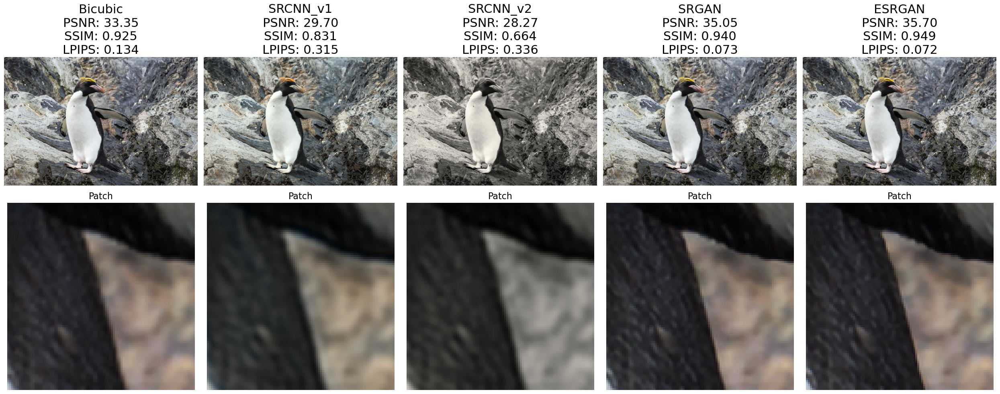


Results for Image 0801.png, scale factor X4:


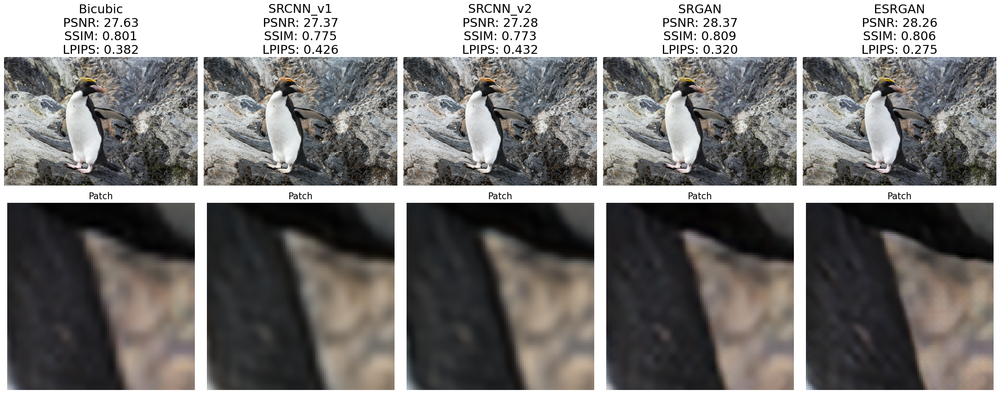


Results for Image 0801.png, scale factor X8:


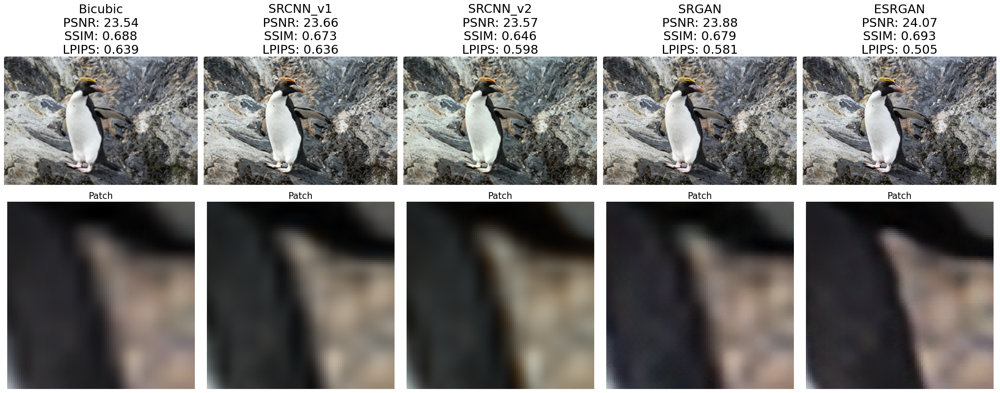


Results for Image 0843.png, scale factor X2:


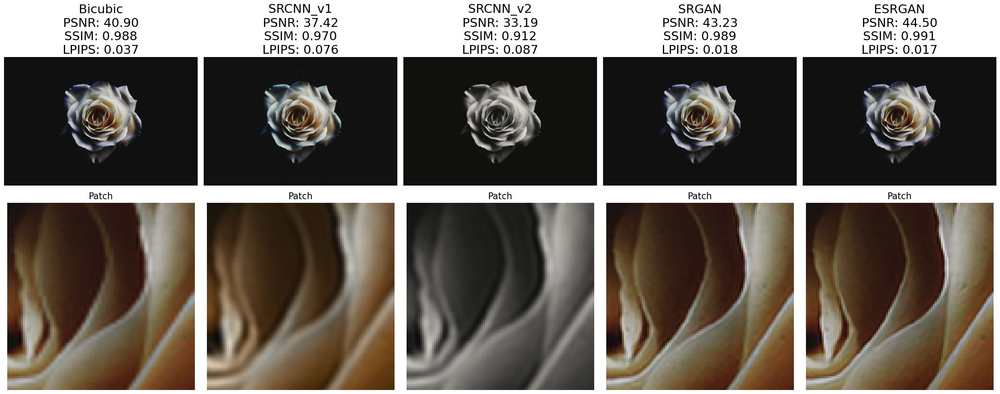


Results for Image 0843.png, scale factor X4:


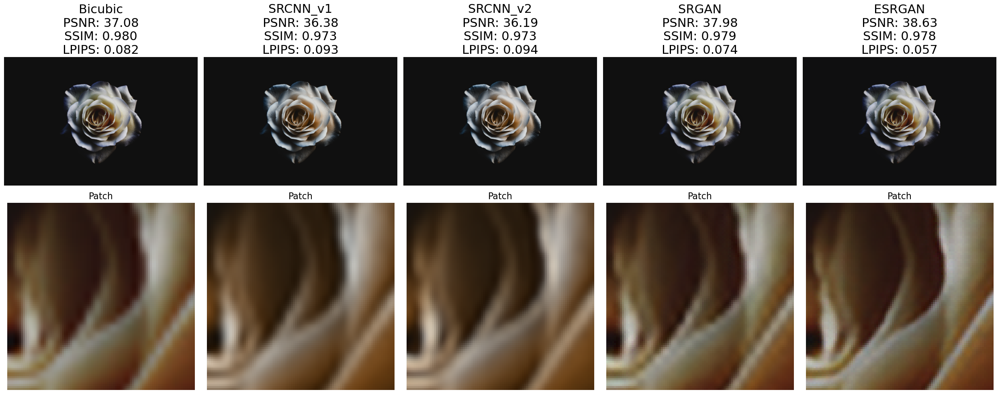


Results for Image 0843.png, scale factor X8:


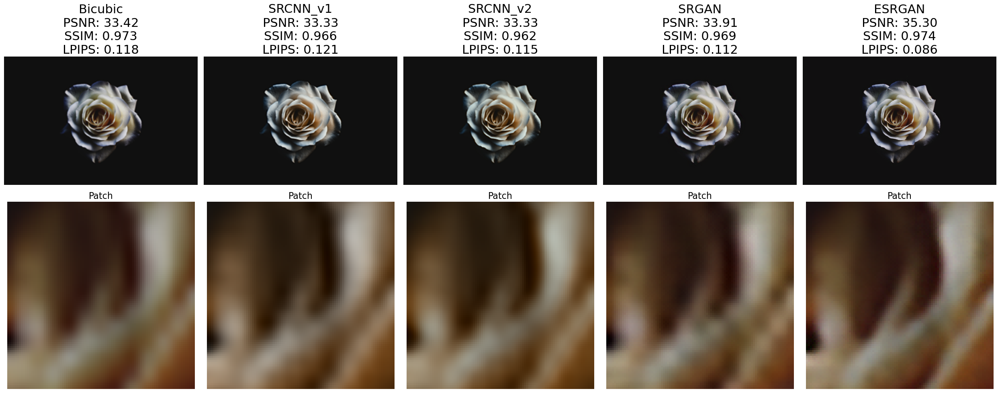


Results for Image 0839.png, scale factor X2:


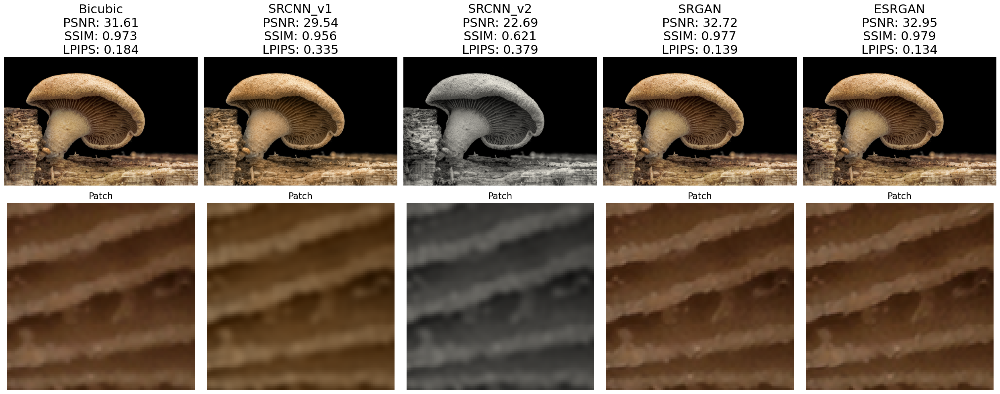


Results for Image 0839.png, scale factor X4:


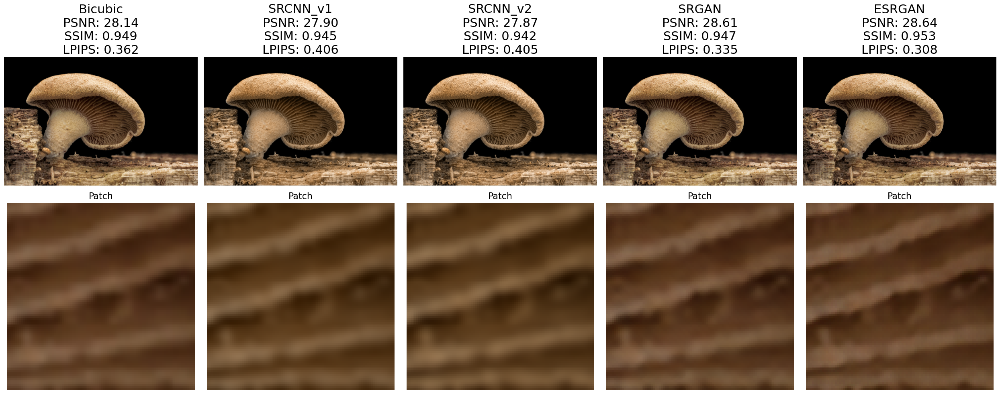


Results for Image 0839.png, scale factor X8:


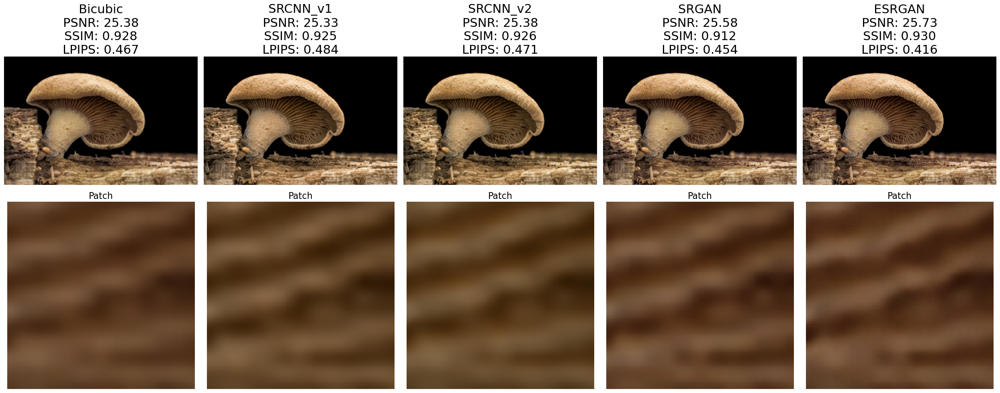


Results for Image 0864.png, scale factor X2:


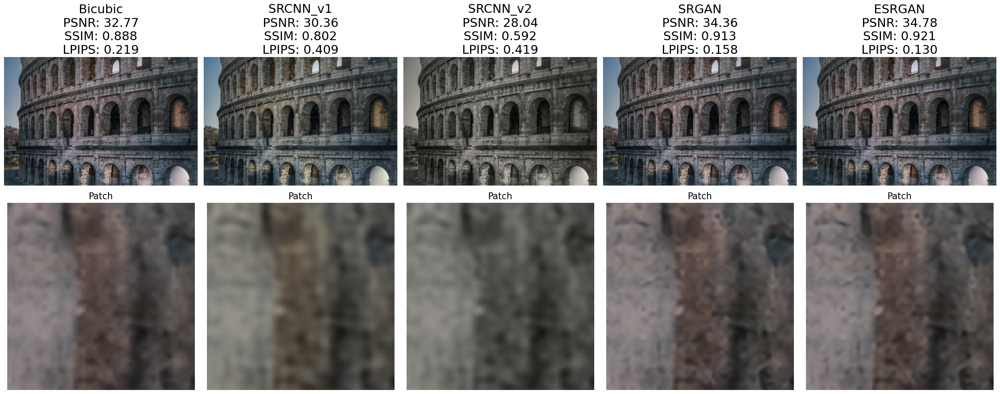


Results for Image 0864.png, scale factor X4:


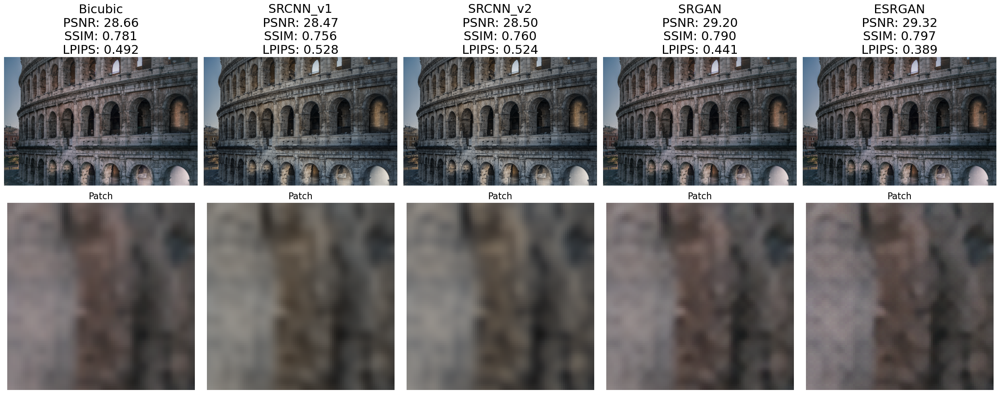


Results for Image 0864.png, scale factor X8:


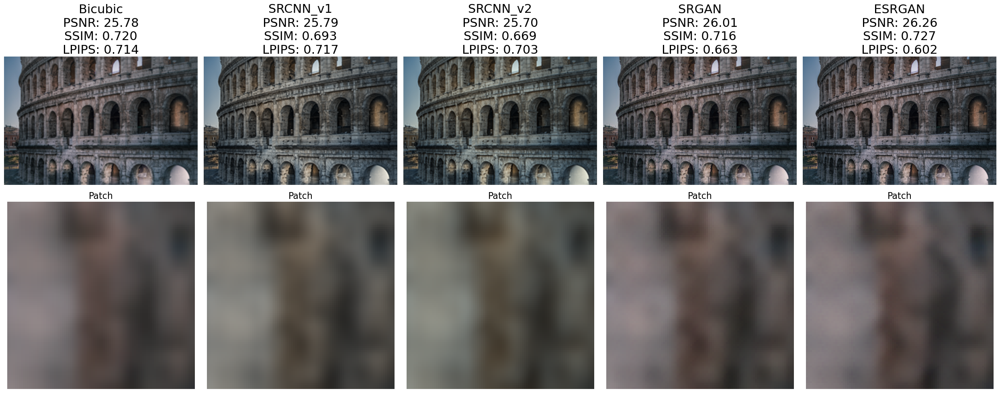


Results for Image 0879.png, scale factor X2:


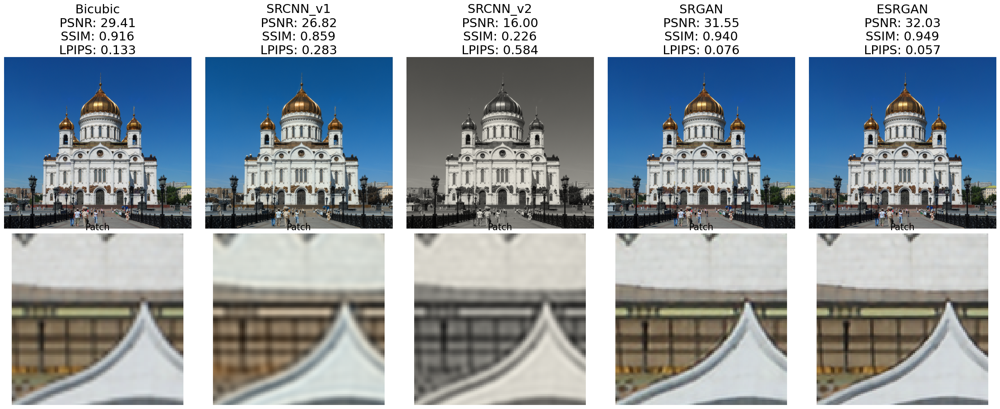


Results for Image 0879.png, scale factor X4:


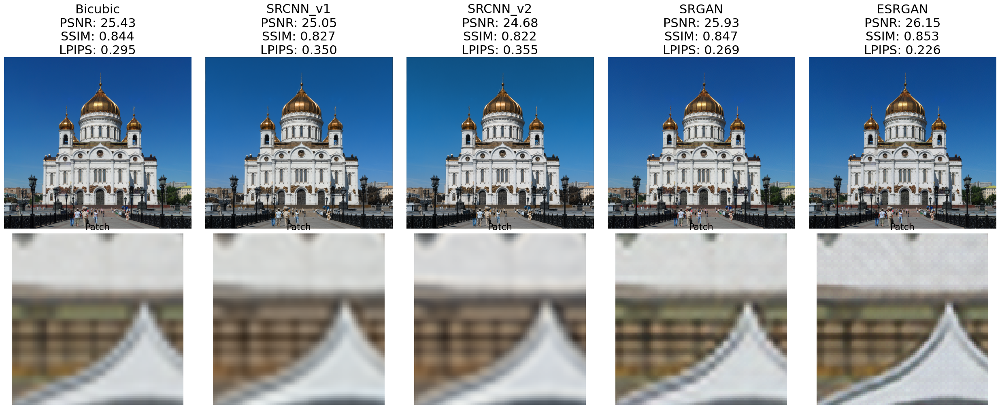


Results for Image 0879.png, scale factor X8:


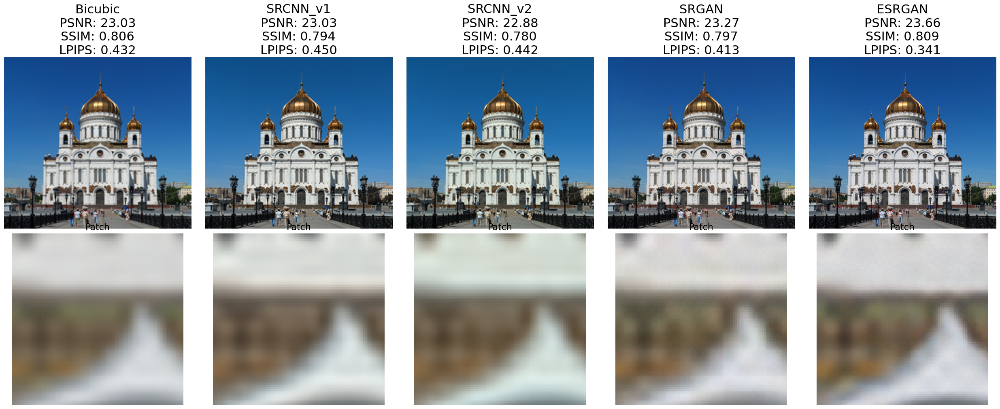


Results for Image 0887.png, scale factor X2:


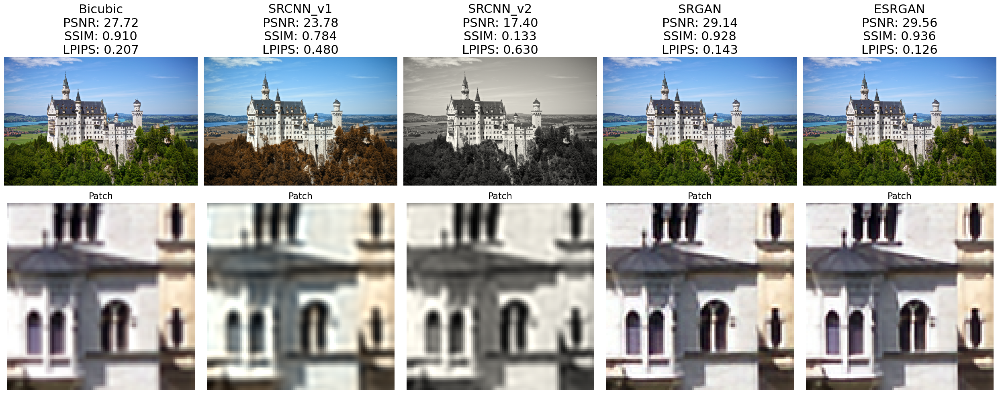


Results for Image 0887.png, scale factor X4:


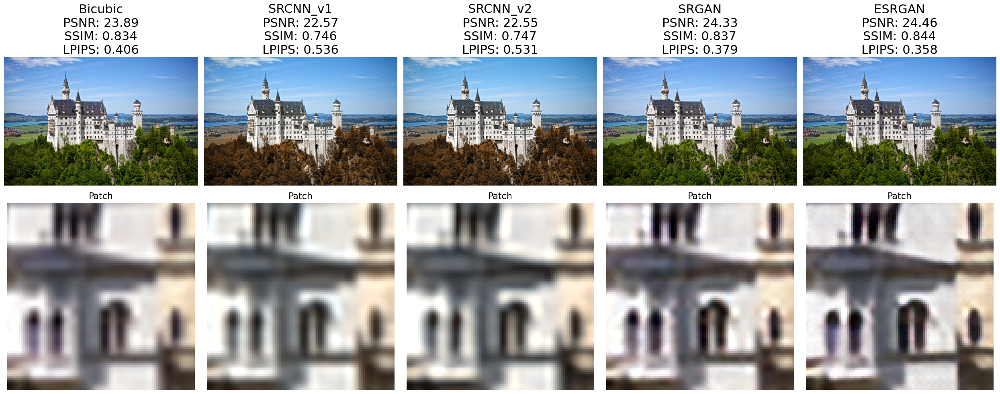


Results for Image 0887.png, scale factor X8:


In [ ]:
import os
import io
import cv2
import shutil
import tempfile
import contextlib
import torch
import lpips
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from pytorch_fid import fid_score

def load_and_preprocess(image_path):
    """
    Loads an image from disk, converts it to a torch tensor, and normalizes it to [-1, 1]
    (which is expected by the LPIPS model).

    Parameters:
        image_path (str): Path to the image.

    Returns:
        torch.Tensor: A tensor with shape (1, 3, H, W) normalized to [-1, 1].
    """
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {image_path}")
    # Convert to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert to float32 and scale to [0, 1]
    img = img.astype(np.float32) / 255.0
    # Normalize to [-1, 1]
    img = (img - 0.5) * 2
    # Convert to torch tensor; shape becomes (1, 3, H, W)
    img_tensor = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0)
    return img_tensor

def center_crop_tensor(img, target_height, target_width):
    """
    Center crops a tensor image.

    Parameters:
        img (torch.Tensor): Tensor of shape (1, C, H, W).
        target_height (int): Target height.
        target_width (int): Target width.

    Returns:
        torch.Tensor: Center-cropped image.
    """
    _, _, height, width = img.shape
    top = (height - target_height) // 2
    left = (width - target_width) // 2
    return img[:, :, top:top+target_height, left:left+target_width]

def crop_to_common_size_tensor(img1, img2):
    """
    Crops two tensor images to their smallest common spatial dimensions.

    Parameters:
        img1, img2 (torch.Tensor): Tensors of shape (1, C, H, W).

    Returns:
        tuple: Cropped tensors with the same spatial dimensions.
    """
    _, _, h1, w1 = img1.shape
    _, _, h2, w2 = img2.shape
    common_h = min(h1, h2)
    common_w = min(w1, w2)
    return center_crop_tensor(img1, common_h, common_w), center_crop_tensor(img2, common_h, common_w)

def compute_lpips(image_path1, image_path2, model='alex'):
    """
    Computes the LPIPS distance between two images.

    Parameters:
        image_path1 (str): Path to the first image.
        image_path2 (str): Path to the second image.
        model (str): Which LPIPS backbone to use ('alex', 'vgg', or 'squeeze').

    Returns:
        float: LPIPS distance (lower means more similar).
    """
    img1 = load_and_preprocess(image_path1)
    img2 = load_and_preprocess(image_path2)
    # Crop tensors if sizes differ.
    if img1.shape != img2.shape:
        img1, img2 = crop_to_common_size_tensor(img1, img2)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    img1, img2 = img1.to(device), img2.to(device)
    f = io.StringIO() # To prevent prints from the LPIPS function from appearing
    with contextlib.redirect_stdout(f):
        loss_fn = lpips.LPIPS(net=model).to(device)
    with torch.no_grad():
        distance = loss_fn(img1, img2).item()
    return distance

def compute_lpips_for_methods(image_name, scale_factor, model='alex'):
    """
    Computes LPIPS for three upscaled versions (Bicubic, SRGAN, ESRGAN) relative to the HR image.

    Assumed file structure:
      - HR:    DIV2K/DIV2K_valid_HR/image_name
      - Bicubic: results/bicubic/X{scale_factor}/image_name
      - SRGAN: results/X{scale_factor}/sr_{image_name}
      - ESRGAN: results/X{scale_factor}/esr_{image_name}

    Parameters:
        image_name (str): The image filename (e.g. "0847.png").
        scale_factor (int): Upscale factor.
        model (str): LPIPS backbone.

    Returns:
        dict: LPIPS distances for 'bicubic', 'srgan', and 'esrgan'.
    """
    hr_path = os.path.join("DIV2K", "DIV2K_valid_HR", image_name)
    bicubic_path = os.path.join("results", "bicubic", f"X{scale_factor}", image_name)
    srcnn_v1_path = os.path.join("results", "srcnn_v1", f"X{scale_factor}", image_name)
    srcnn_v2_path = os.path.join("results", "srcnn_v2", f"X{scale_factor}", image_name)
    srgan_path = os.path.join("results", f"X{scale_factor}", f"sr_{image_name}")
    esrgan_path = os.path.join("results", f"X{scale_factor}", f"esr_{image_name}")
    
    lpips_bicubic = compute_lpips(hr_path, bicubic_path, model)
    lpips_srcnn_v1 = compute_lpips(hr_path, srcnn_v1_path, model)
    lpips_srcnn_v2 = compute_lpips(hr_path, srcnn_v2_path, model)
    lpips_srgan   = compute_lpips(hr_path, srgan_path, model)
    lpips_esrgan  = compute_lpips(hr_path, esrgan_path, model)
    
    return {
        'bicubic': lpips_bicubic,
        'srcnn_v1': lpips_srcnn_v1,
        'srcnn_v2': lpips_srcnn_v2,
        'srgan': lpips_srgan,
        'esrgan': lpips_esrgan,
    }

def crop_to_match_np(img, target_img):
    """
    Center crops the first image (numpy array) to match the dimensions of target_img.

    Parameters:
        img (np.ndarray): Source image.
        target_img (np.ndarray): Target image whose dimensions will be used.

    Returns:
        np.ndarray: Cropped version of img.
    """
    h1, w1, _ = img.shape
    h2, w2, _ = target_img.shape
    new_h = min(h1, h2)
    new_w = min(w1, w2)
    top = (h1 - new_h) // 2
    left = (w1 - new_w) // 2
    return img[top:top+new_h, left:left+new_w, :]



def display_results(image_name, scale_factor, lpips_model='alex'):
    """
    Displays LR, Bicubic, SRGAN, ESRGAN, and HR images side by side.
    Also computes PSNR, SSIM, and LPIPS for each upscaled image against HR.
    A second row shows a fixed-size patch from each image:
      - For LR: a 32x32 patch (due to the downscaled resolution)
      - For the other images: a 64x64 patch.
    
    Assumed file structure:
      - LR:       DIV2K/DIV2K_valid_LR/X{scale_factor}/image_name
      - HR:       DIV2K/DIV2K_valid_HR/image_name
      - Bicubic:  results/bicubic/X{scale_factor}/image_name
      - SRGAN:    results/X{scale_factor}/sr_{image_name}
      - ESRGAN:   results/X{scale_factor}/esr_{image_name}
    """
    import matplotlib.pyplot as plt

    # Define file paths.
    hr_path = os.path.join("DIV2K", "DIV2K_valid_HR", image_name)
    bicubic_path = os.path.join("results", "bicubic", f"X{scale_factor}", image_name)
    srcnn_v1_path = os.path.join("results", "srcnn_v1", f"X{scale_factor}", image_name)
    srcnn_v2_path = os.path.join("results", "srcnn_v2", f"X{scale_factor}", image_name)
    srgan_path = os.path.join("results", f"X{scale_factor}", f"sr_{image_name}")
    esrgan_path = os.path.join("results", f"X{scale_factor}", f"esr_{image_name}")
    
    def read_image(path):
        img = cv2.imread(path)
        if img is None:
            raise FileNotFoundError(f"Image not found: {path}")
        return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Load images as numpy arrays.
    hr = read_image(hr_path)
    bicubic = read_image(bicubic_path)
    srcnn_v1 = read_image(srcnn_v1_path)
    srcnn_v2 = read_image(srcnn_v2_path)
    srgan = read_image(srgan_path)
    esrgan = read_image(esrgan_path)
    
    # Define helper to compute PSNR and SSIM with cropping if needed.
    def calc_metrics(upscaled):
        # Crop HR to match upscaled if dimensions differ.
        if hr.shape != upscaled.shape:
            hr_matched = crop_to_match_np(hr, upscaled)
        else:
            hr_matched = hr
        psnr = peak_signal_noise_ratio(hr_matched, upscaled)
        ssim = structural_similarity(hr_matched, upscaled, win_size=3, multichannel=True)
        return psnr, ssim
    
    psnr_bicubic, ssim_bicubic = calc_metrics(bicubic)
    psnr_srcnn_v1, ssim_srcnn_v1 = calc_metrics(srcnn_v1)
    psnr_srcnn_v2, ssim_srcnn_v2 = calc_metrics(srcnn_v2)
    psnr_srgan, ssim_srgan = calc_metrics(srgan)
    psnr_esrgan, ssim_esrgan = calc_metrics(esrgan)
    
    # Compute LPIPS scores (LPIPS is computed using torch tensors)
    lpips_results = compute_lpips_for_methods(image_name, scale_factor, model=lpips_model)
    
    # Define a helper to extract a fixed-size patch from the center of an image.
    def extract_patch(img, patch_height, patch_width):
        h, w, _ = img.shape
        top = (h - patch_height) // 2
        left = (w - patch_width) // 2
        return img[top:top+patch_height, left:left+patch_width, :]
    
    # Set patch sizes.
    patch = 96
    patch_size = (patch, patch)         # For the other images.
    lr_patch_size = (patch//scale_factor, patch//scale_factor)     # For the LR image.
    
    # Create a figure with 2 rows and 5 columns.
    fig, axes = plt.subplots(2, 5, figsize=(25, 10))
    
    # Top row: Full images.
    images = [bicubic, srcnn_v1, srcnn_v2, srgan, esrgan]
    titles = [
        f"Bicubic\nPSNR: {psnr_bicubic:.2f}\nSSIM: {ssim_bicubic:.3f}\nLPIPS: {lpips_results['bicubic']:.3f}",
        f"SRCNN_v1\nPSNR: {psnr_srcnn_v1:.2f}\nSSIM: {ssim_srcnn_v1:.3f}\nLPIPS: {lpips_results['srcnn_v1']:.3f}",
        f"SRCNN_v2\nPSNR: {psnr_srcnn_v2:.2f}\nSSIM: {ssim_srcnn_v2:.3f}\nLPIPS: {lpips_results['srcnn_v2']:.3f}",
        f"SRGAN\nPSNR: {psnr_srgan:.2f}\nSSIM: {ssim_srgan:.3f}\nLPIPS: {lpips_results['srgan']:.3f}",
        f"ESRGAN\nPSNR: {psnr_esrgan:.2f}\nSSIM: {ssim_esrgan:.3f}\nLPIPS: {lpips_results['esrgan']:.3f}",
    ]
    
    for idx, (img, title) in enumerate(zip(images, titles)):
        axes[0, idx].imshow(img)
        axes[0, idx].set_title(title, fontsize=22)
        axes[0, idx].axis('off')
    
    # Bottom row: Fixed patch from each image.
    for idx, img in enumerate(images):
        patch = extract_patch(img, *patch_size)
        axes[1, idx].imshow(patch)
        axes[1, idx].set_title("Patch", fontsize=16)
        axes[1, idx].axis('off')
    
    plt.tight_layout()
    plt.show()

images = ["0801.png", "0843.png", "0839.png","0864.png", "0879.png", "0887.png", "0898.png"]
scales = [2, 4, 8]
for test_image in images:
    for scale in scales:
        print(f"\nResults for Image {test_image}, scale factor X{scale}:")
        display_results(test_image, scale, lpips_model='alex')
